In [1]:
from langchain.prompts import (
    PromptTemplate,
)
import json
import boto3
import re
from config import config
from typing import List
from aws.claude import BedrockClaude
from utils import *

In [2]:
PROMPT = """You are an Assistant that creates prompts for generate image by image generator model. The image that Human wants is written in <request>.
Follow style guide in <style> and write three image creating prompts. Use this fomat without further explanation: 
<prompt>prompt</prompt>

<request>
{request}
</request>

<style>
{system}
</style>
"""

def get_prompt(request, system=None): 
    if not system:
        system = "minimalist, simple, clean and abstract background image, and do not contain many patterns, logos, or letters."
    return PromptTemplate(
                template=PROMPT,
                input_variables=["system", "request"]
            ).format(system=system,
                     request=request)

def generate_image(body: str, model_id: str = 'amazon.titan-image-generator-v2:0'):
    bedrock = boto3.client(service_name='bedrock-runtime',
                           region_name = config.BEDROCK_REGION)

    accept = "application/json"
    content_type = "application/json"

    response = bedrock.invoke_model(
        body=body, modelId=model_id, accept=accept, contentType=content_type
    )
    response_body = json.loads(response.get("body").read())
    return response_body.get("images")

def get_prompt_by_llm(prompt: str) -> List[str]:
    claude = BedrockClaude()
    res = claude.invoke_llm_response(prompt)

    pattern = r'<prompt>(.*?)</prompt>'
    image_prompts = re.findall(pattern, res)
    return image_prompts

In [47]:
prompt = get_prompt(request='olympic')
image_prompts = get_prompt_by_llm(prompt)
print(image_prompts)

['A minimalist illustration of the Olympic rings, rendered as simple geometric shapes against a plain white background.', 'An abstract composition featuring the iconic Olympic torch, represented by a single bold line against a vast, empty canvas.', 'A clean and minimalist depiction of an Olympic medal, with its circular form and ribbon rendered in a simple, flat design style against a solid-colored backdrop.']


A minimalist illustration of the Olympic rings, rendered as simple geometric shapes against a plain white background.



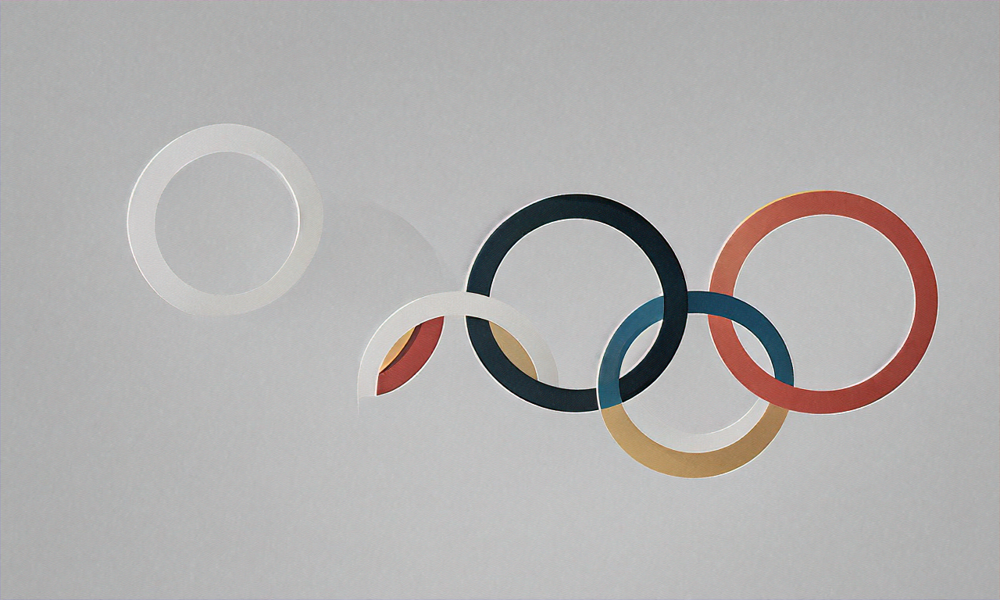


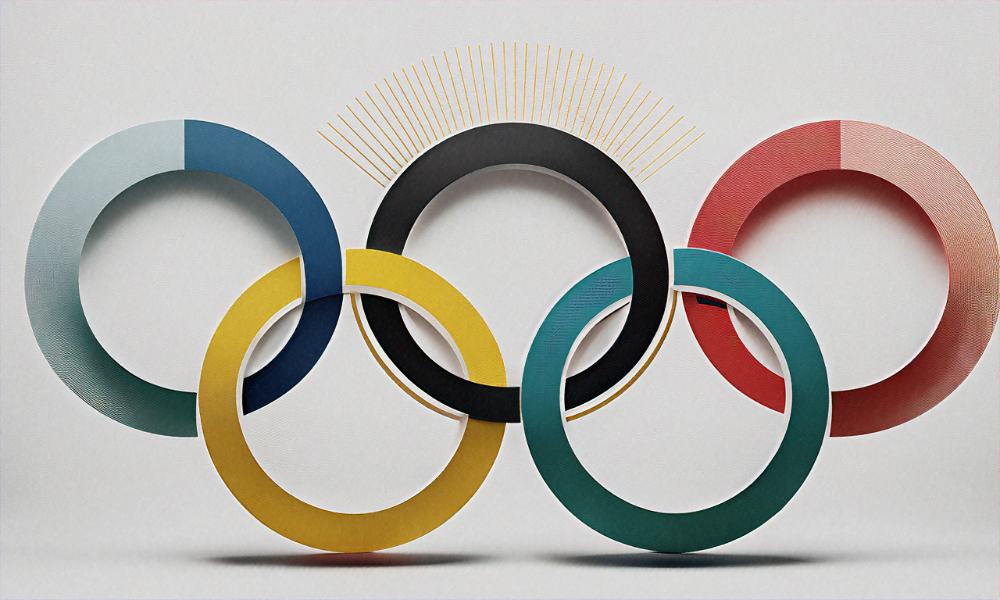

An abstract composition featuring the iconic Olympic torch, represented by a single bold line against a vast, empty canvas.



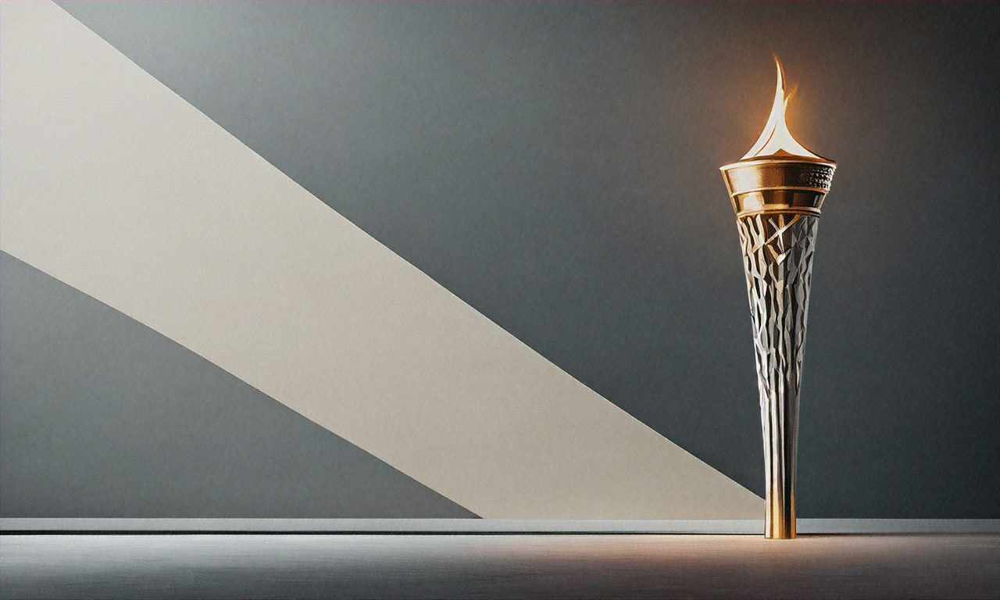


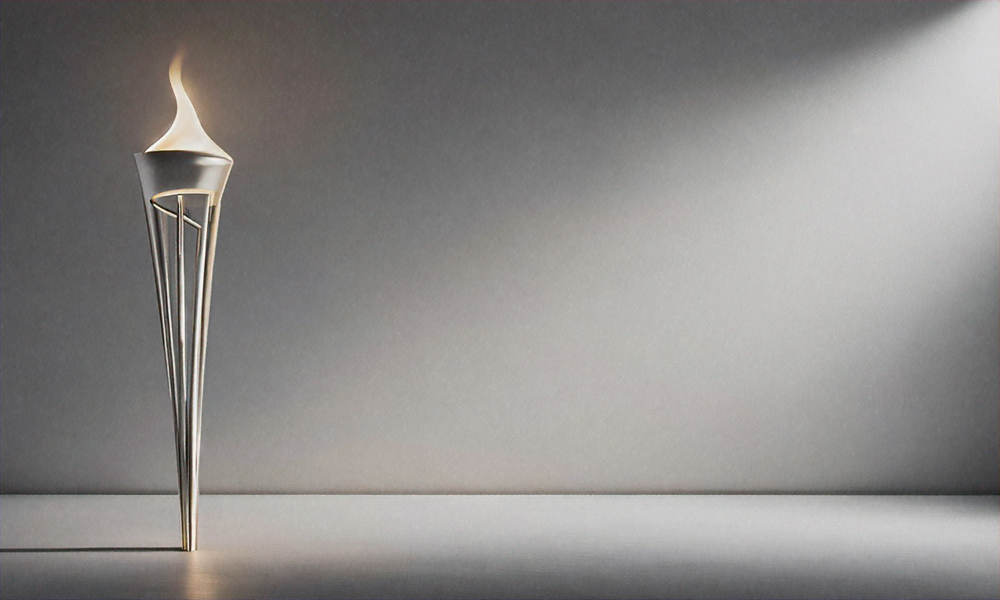

A clean and minimalist depiction of an Olympic medal, with its circular form and ribbon rendered in a simple, flat design style against a solid-colored backdrop.



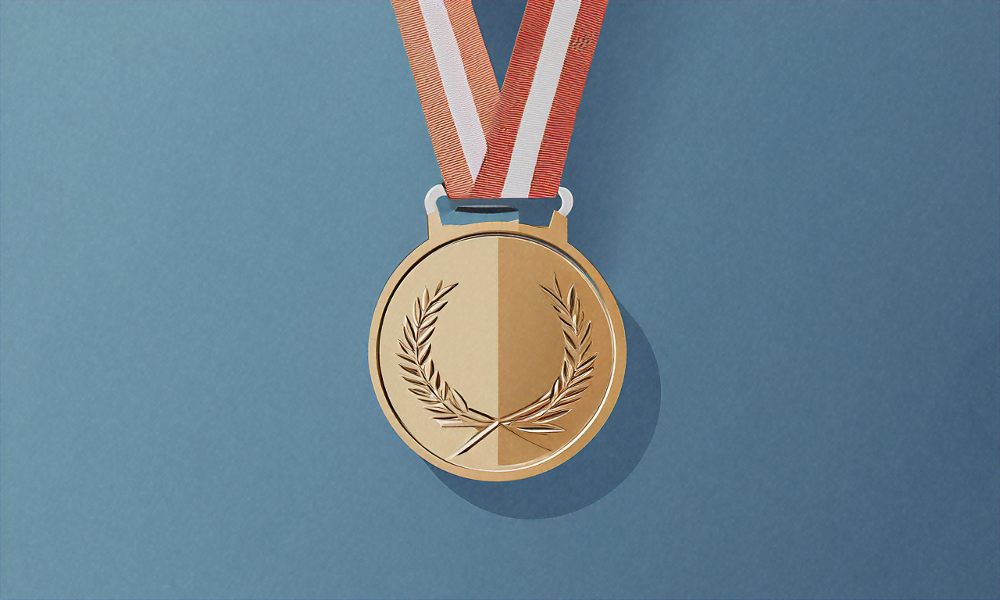


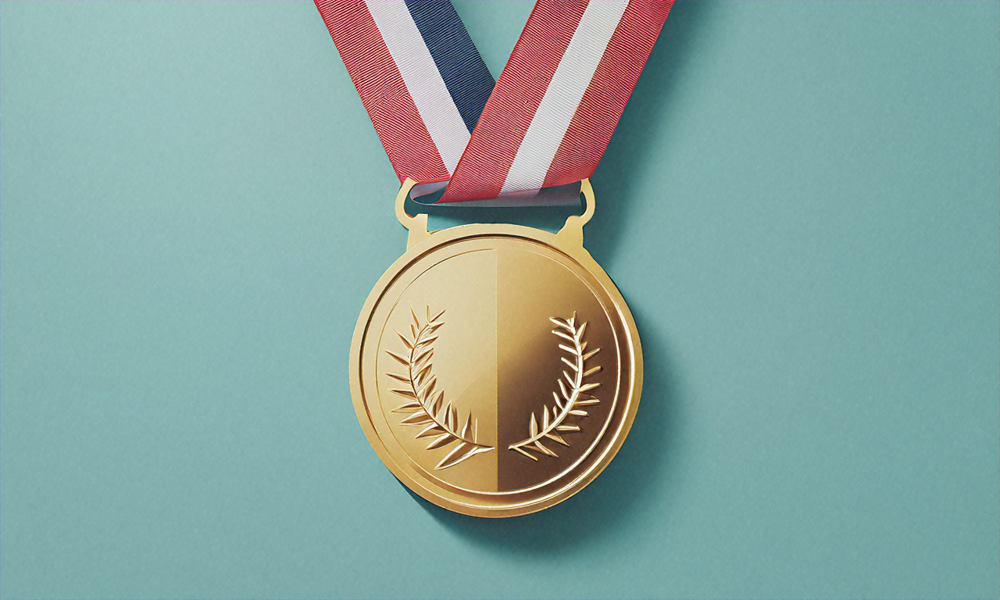

Simple abstract background with Olympic colors: blue, yellow, black, green, and red. Minimalist design, no logos or complex patterns. Soft gradients and geometric shapes. Clean and modern look. High resolution, digital art style.



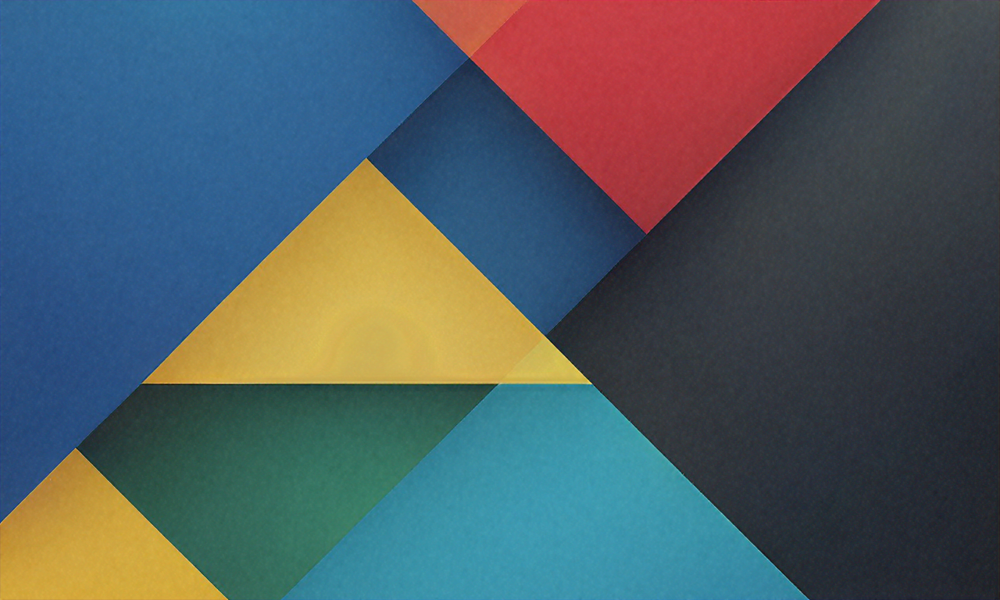


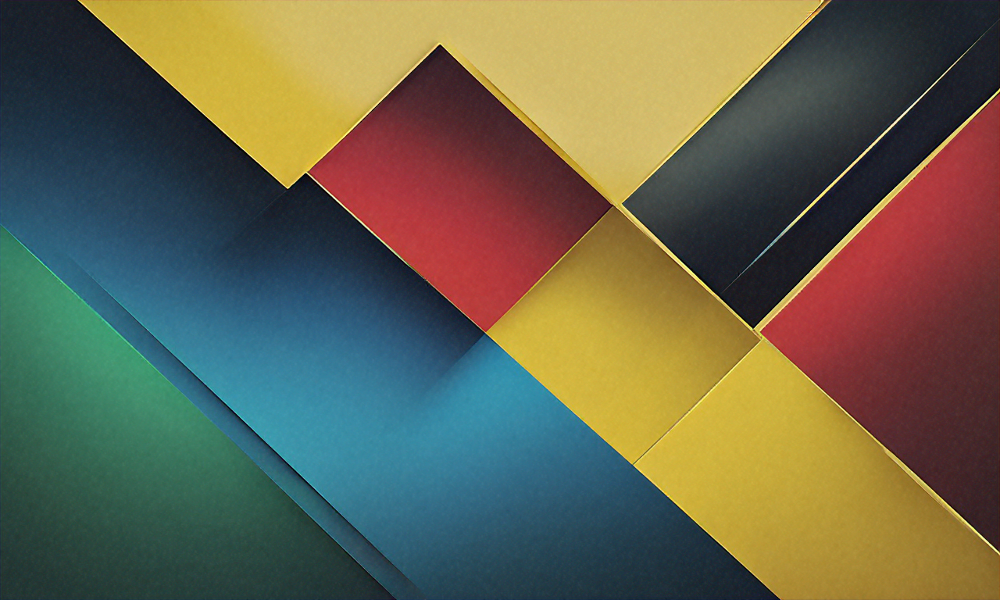

In [51]:
for prompt in image_prompts:
    body = {
        "taskType": "TEXT_IMAGE",
        "textToImageParams": {
            "text": prompt,
        },
        "imageGenerationConfig": {
            "numberOfImages": 2,
            "quality": "standard",
            "cfgScale": 8.0,
            "width": 1280,
            "height": 768,
            "seed": 0,
        },
    }

    print('====================')
    print(prompt)
    imgs = generate_image(body=json.dumps(body))
    for img in imgs:
        display_image(img)

A minimalist landscape with soft, rolling green hills against a pale blue sky with wispy white clouds. The scene is simple and uncluttered, with no buildings or other man-made structures visible.



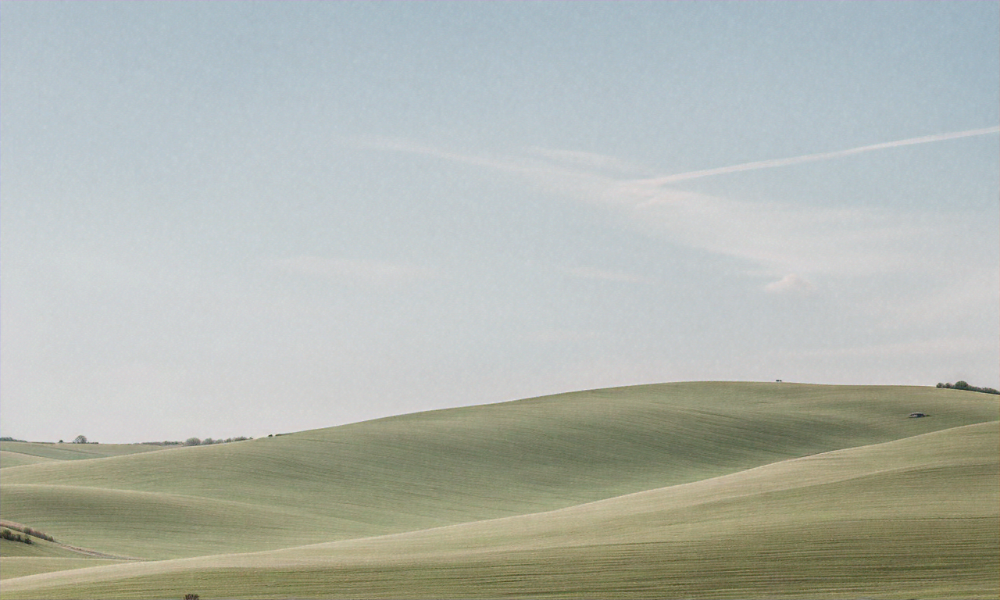


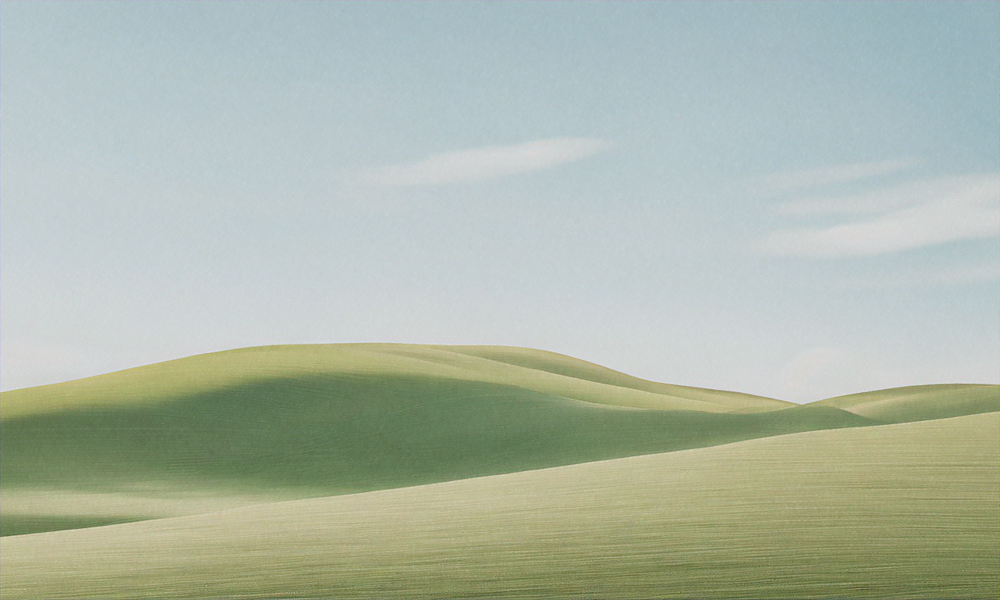

An abstract background with a gradient of muted, earthy tones blending from light beige to sage green. The colors transition smoothly with no harsh lines or patterns, creating a clean and calming atmosphere.



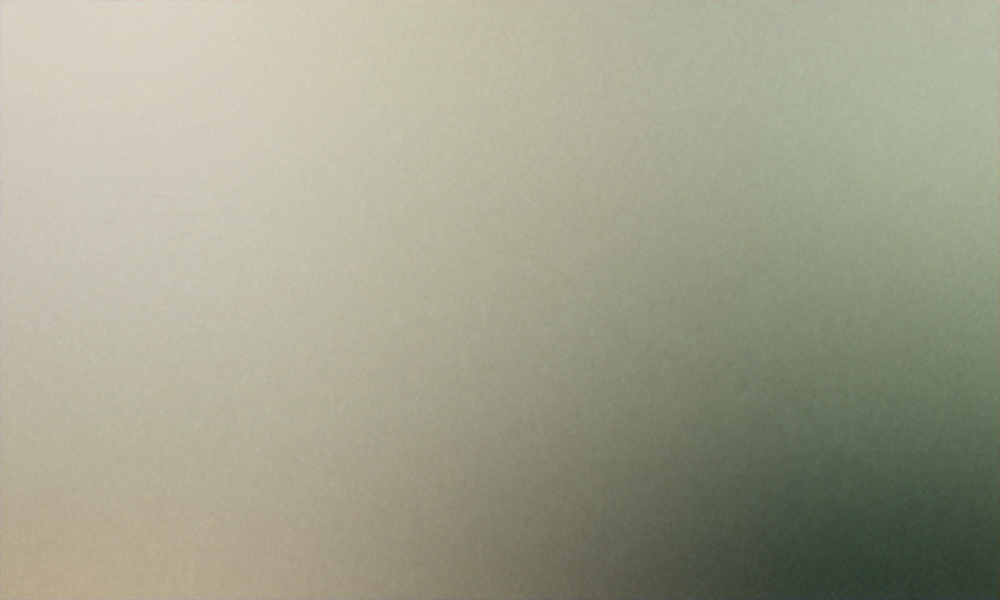


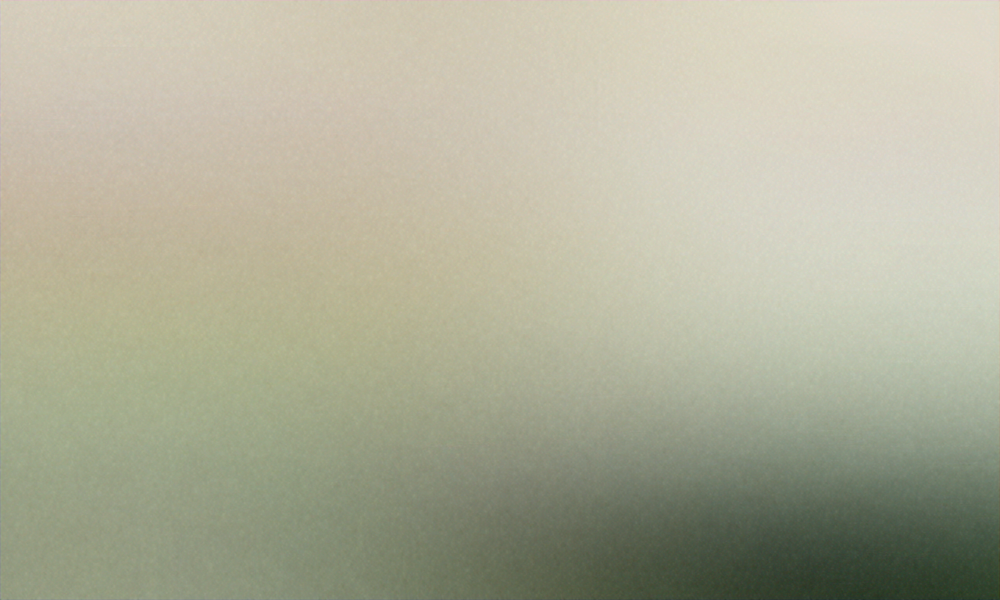

A serene scene of a single, slender tree silhouetted against a hazy, golden sunset sky. The tree is a simple black shape, and the background is a smooth gradient from pale yellow to deep orange, with no other elements or details.



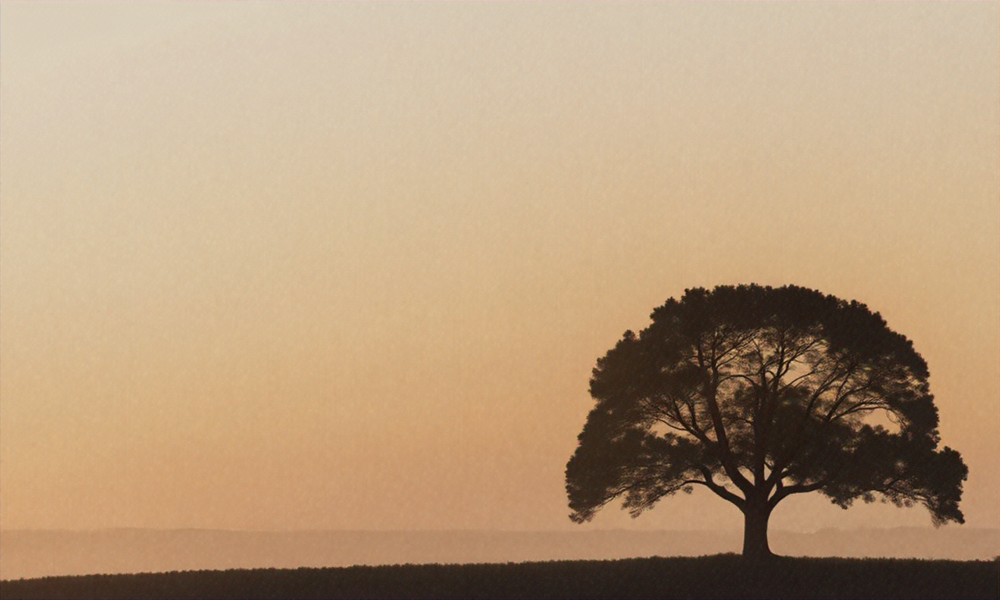


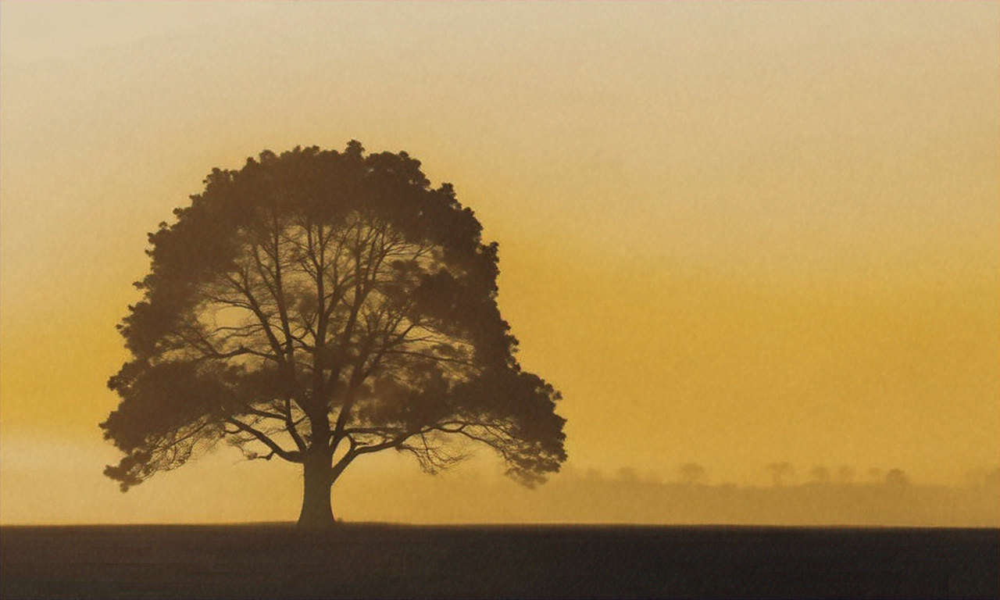

In [3]:
for prompt in get_prompt_by_llm(get_prompt(request='')):
    body = {
        "taskType": "TEXT_IMAGE",
        "textToImageParams": {
            "text": prompt,
        },
        "imageGenerationConfig": {
            "numberOfImages": 2,
            "quality": "standard",
            "cfgScale": 8.0,
            "width": 1280,
            "height": 768,
            "seed": 0,
        },
    }

    print('====================')
    print(prompt)
    imgs = generate_image(body=json.dumps(body))
    for img in imgs:
        display_image(img)